<a href="https://colab.research.google.com/github/greenfire0/ucla_project/blob/master/better.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import os


from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
apex = pd.read_csv('/content/drive/MyDrive/locatiopns_final.csv')
f1 = pd.DataFrame([{'x': 285, 'y': 991, 'time':760},
                  {'x':200, 'y': 1200, 'time': 760}])
apex = pd.concat([f1,apex], ignore_index=True)
apex = (apex[~(apex['x'] >= 1500)])
apex = (apex[~(apex['y'] >= 1500)])
apex = (apex[~(apex['y'] <= 0)]) 
apex = (apex[~(apex['y'] <= 150)])


apex.head()


,x,y,time
0,285,991,760.00
1,200,1200,760.00
2,838,972,64.54
3,839,973,67.60
4,844,966,70.13


In [ ]:
apex.head()

apex['y'] = apex['y']-(2*((apex['y']-750)))
print(apex['y'])
tx1 = apex[(apex['time'] >= 0) & (apex['time'] <= 100)]
tx2 = apex[(apex['time'] >= 101) & (apex['time'] <= 200)]
tx3 = apex[(apex['time'] >= 201) & (apex['time'] <= 300)]
tx4 = apex[(apex['time'] >= 301) & (apex['time'] <= 400)]
tx5 = apex[(apex['time'] >= 401) & (apex['time'] <= 500)]
tx6 = apex[(apex['time'] >= 501) & (apex['time'] <= 600)]
tx7 = apex[(apex['time'] >= 601) & (apex['time'] <= 700)]
tx8 = apex[(apex['time'] >= 701) & (apex['time'] <= 800)]
tx9 = apex[(apex['time'] >= 801) & (apex['time'] <= 900)]
tx10 = apex[(apex['time'] >=901) & (apex['time'] <= 1000)]
tx11= apex[(apex['time'] >= 1001) & (apex['time'] <= 1100)] 
tx12 = apex[(apex['time'] >= 1101) & (apex['time'] <= 1200)]
tx13 = apex[(apex['time'] >= 1201) & (apex['time'] <= 1300)]
tx14 = apex[(apex['time'] >= 1301) & (apex['time'] <= 1400)]
tx15 = apex[(apex['time'] >= 1401) & (apex['time'] <= 1500)]


tx = []
x=0
 
while x <= 1500:
  tx.append(apex[(apex['time'] >= x) & (apex['time'] <= x+10)])
  x+=10




alive = apex['time']

0          509
1          300
2          528
3          527
4          534
          ... 
1746348    464
1746349    463
1746350    459
1746351    459
1746352    455
Name: y, Length: 1746078, dtype: int64


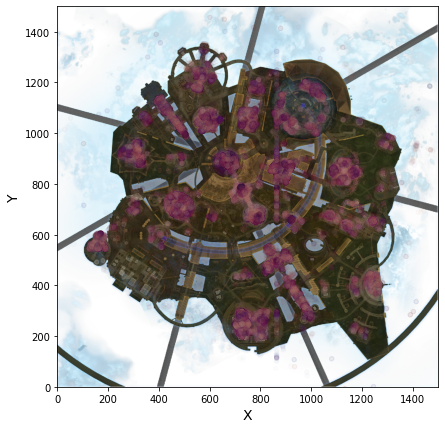

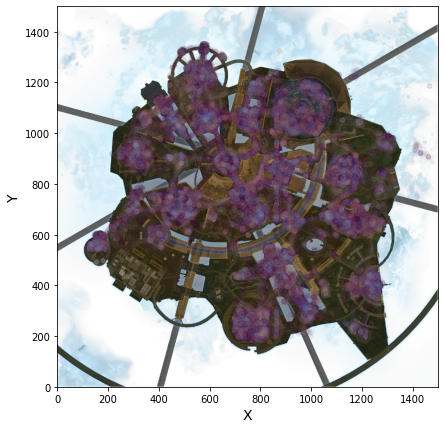

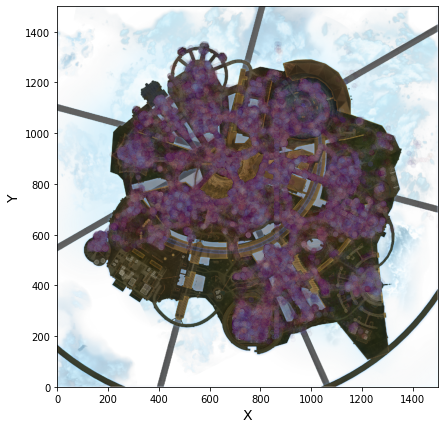

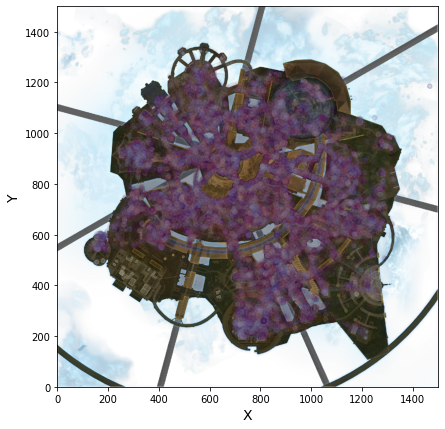

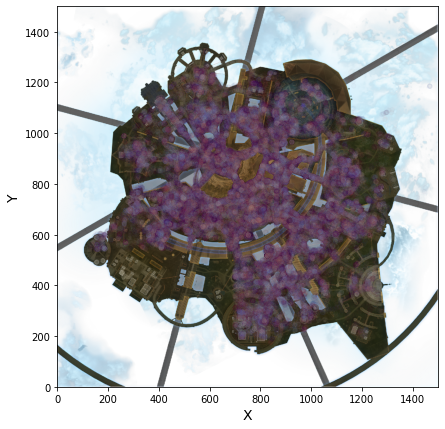

...

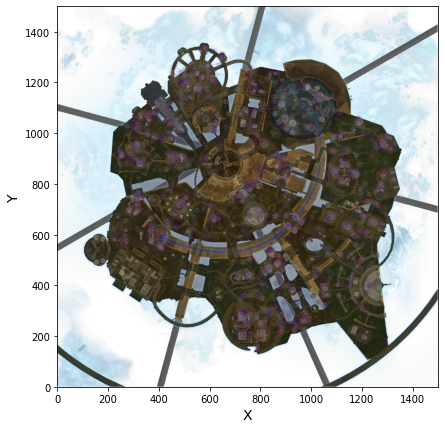

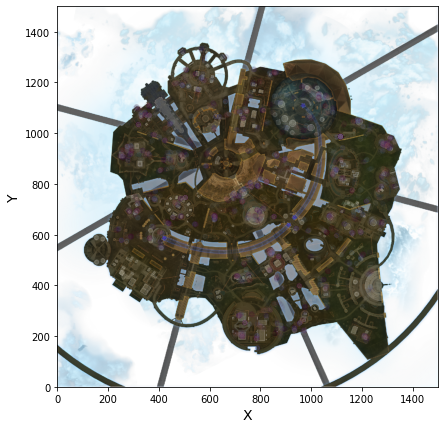

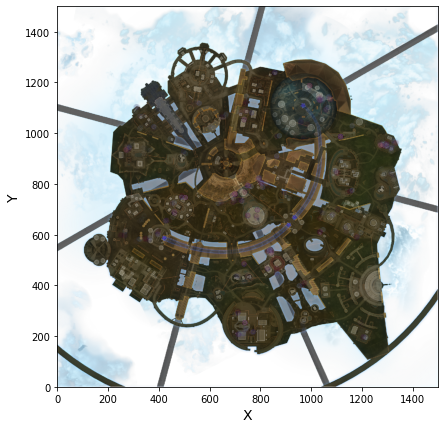

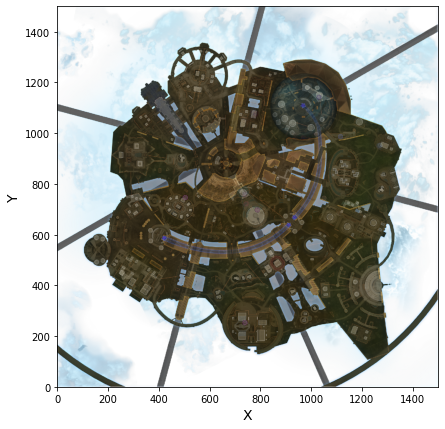

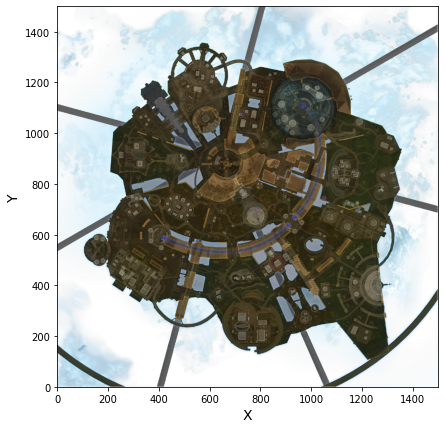

In [ ]:
#tx = [tx8]

images_path = os.path.join('./', "/content/drive/MyDrive/")
os.makedirs(images_path, exist_ok=True)
filename = "L01,R1,C1,background,visible,normal,255.png"
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
for loop in tx:
  map_img=mpimg.imread(os.path.join(images_path, filename))
  ax = loop.plot(kind='scatter', x="x", y="y", figsize=(10,7), c="time",
                      
                        cmap=plt.get_cmap("twilight"),
                       colorbar=False, alpha=0.02,
                      )

  plt.imshow(map_img, extent=[0, 1500, 0, 1500], alpha=1,
          cmap=plt.get_cmap("jet"))
  plt.ylabel("Y", fontsize=14)
  plt.xlabel("X", fontsize=14)

# setting up heatmap

  tick_values = np.linspace(alive.min(), alive.max(), 11)



plt.show()

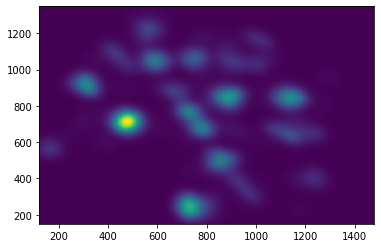

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import kde
 
# create data
x = np.random.normal(size=500)
y = x * 3 + np.random.normal(size=500)
x = np.array(tx[1]["x"].tolist()) 
y = np.array(tx[1]["y"].tolist()) 

# Evaluate a gaussian kde on a regular grid of nbins x nbins over data extents
nbins=300
k = kde.gaussian_kde([x,y])
xi, yi = np.mgrid[x.min():x.max():nbins*1j, y.min():y.max():nbins*1j]
zi = k(np.vstack([xi.flatten(), yi.flatten()]))

# Make the plot
plt.pcolormesh(xi, yi, zi.reshape(xi.shape), shading='auto')
plt.show()
 
# Change color palette


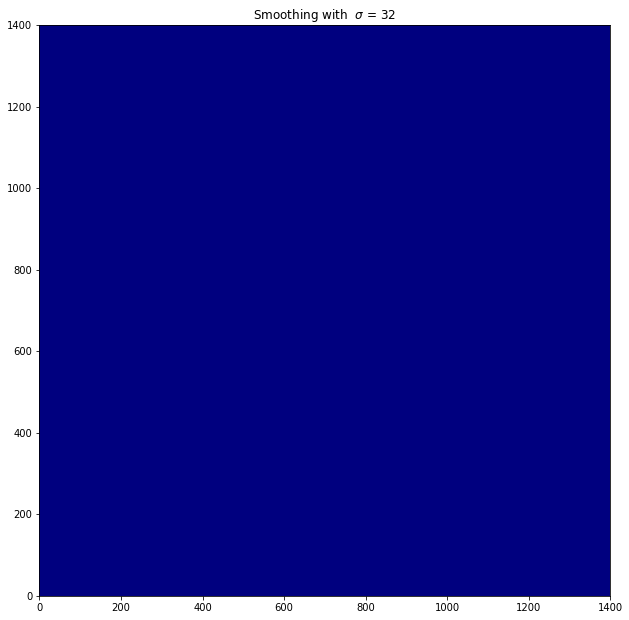

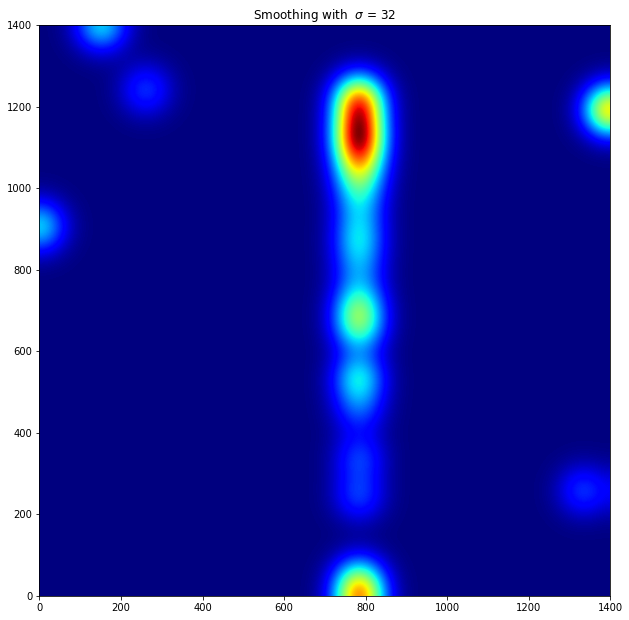

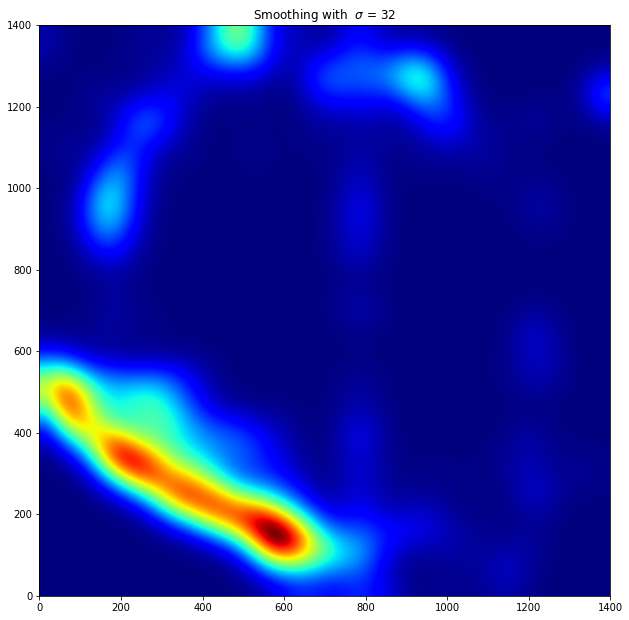

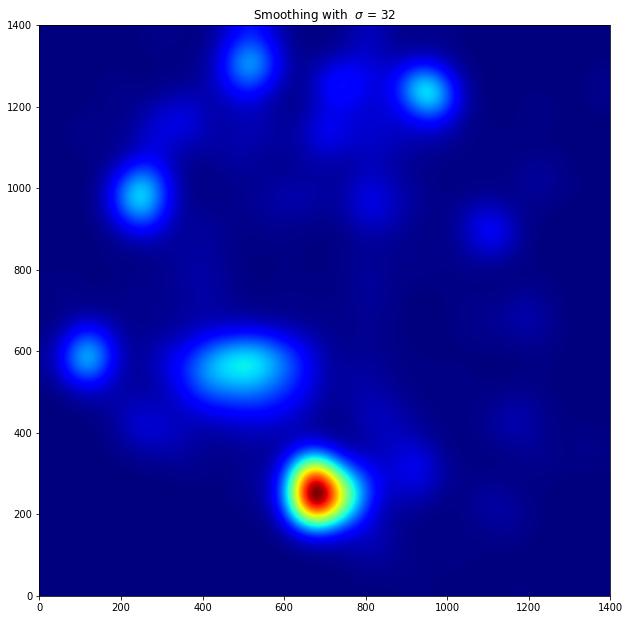

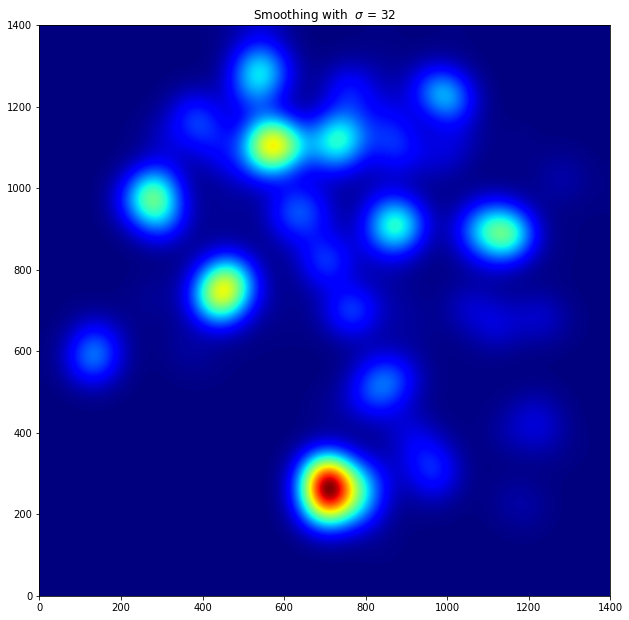

...

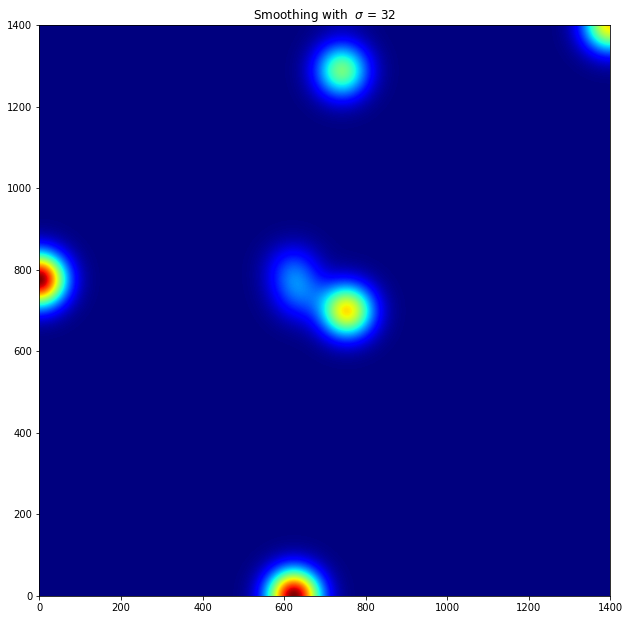

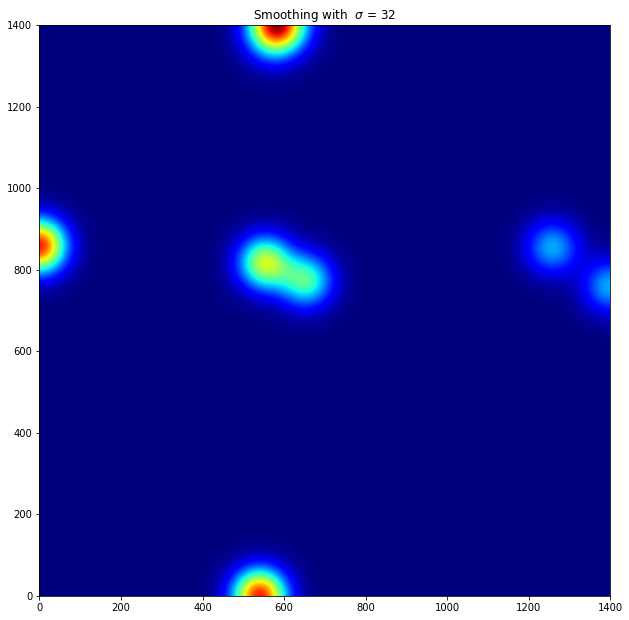

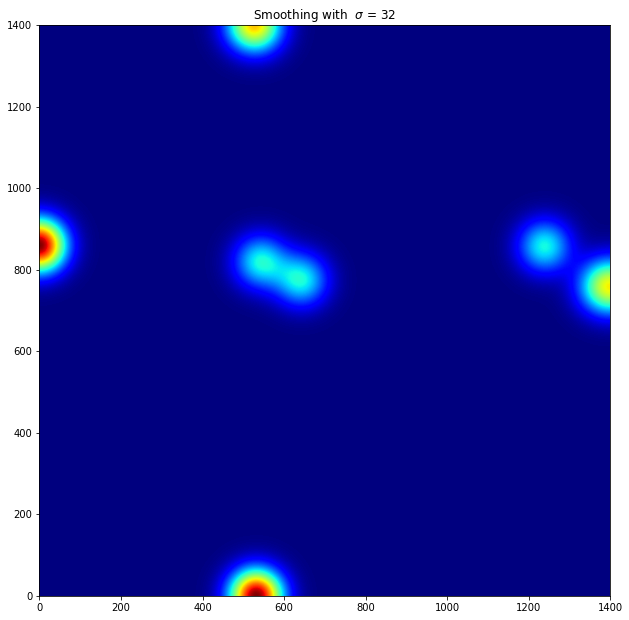

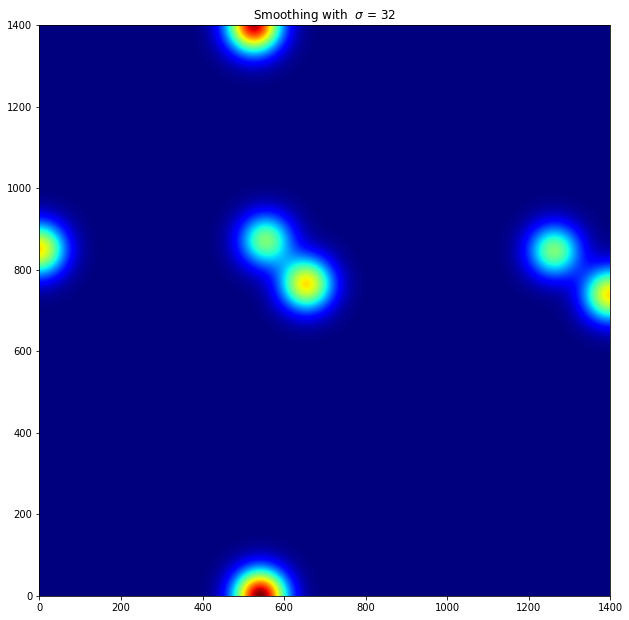

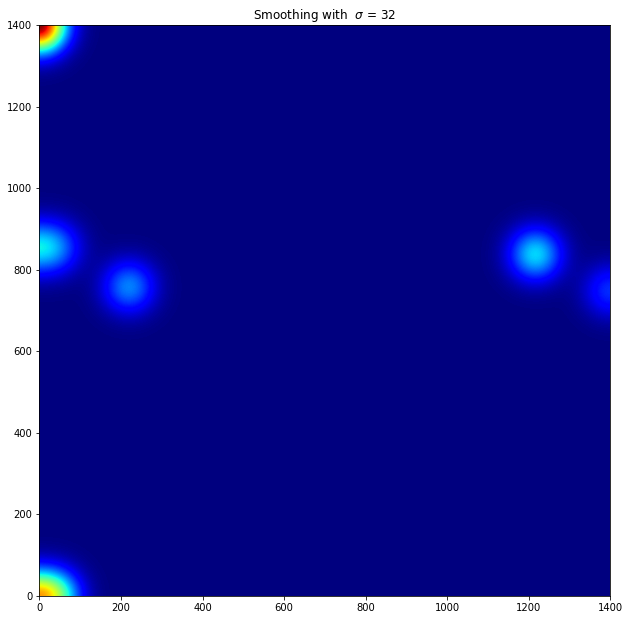

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from scipy.ndimage.filters import gaussian_filter


def myplot(x, y, s, bins=1000):
    heatmap, xedges, yedges = np.histogram2d(x, y, bins=bins)
    heatmap = gaussian_filter(heatmap, sigma=s)

    extent = [xedge[0], xedge[1], yedge[0], yedge[1]]
    return heatmap.T, extent
count = 0
for a in tx:
  fig, axs = plt.subplots(1)

# Generate some test data
  x = np.array(a["x"].tolist()) 
  y = np.array(a["y"].tolist()) 

  sigmas = [32]
  xedge = [0,1400]
  yedge =[0,1400]
  count+=1
  for s in sigmas:
         
        img, extent = myplot(x, y, s)
        axs.imshow(img, extent=extent, origin='lower', cmap=cm.jet)
        axs.set_title("Smoothing with  $\sigma$ = %d" % s)
        plt.ylim([0,1400])
        plt.xlim([0,1400])
        plt.savefig(str(count))
  
  fig.set_size_inches(18.5, 10.5)
  plt.show()

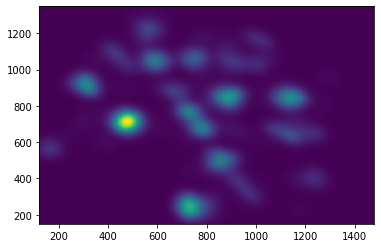

1349
1479


In [ ]:
x = np.array(tx[1]["x"].tolist()) 
y = np.array(tx[1]["y"].tolist()) 


xi, yi = np.mgrid[x.min():x.max():nbins*1j, y.min():y.max():nbins*1j]
plt.pcolormesh(xi, yi, zi.reshape(xi.shape), shading='auto')
plt.show()
print(y.max())
print(x.max())

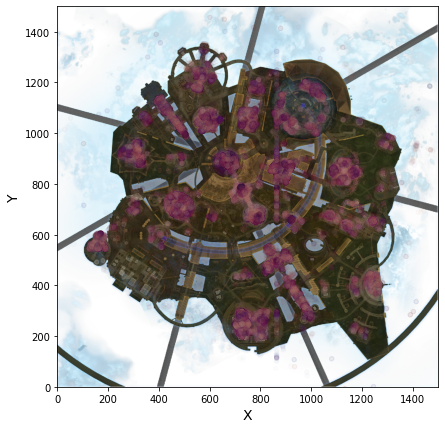

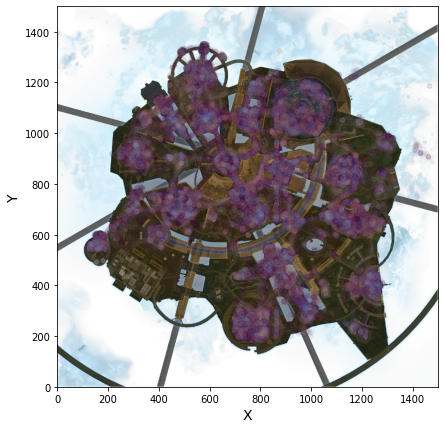

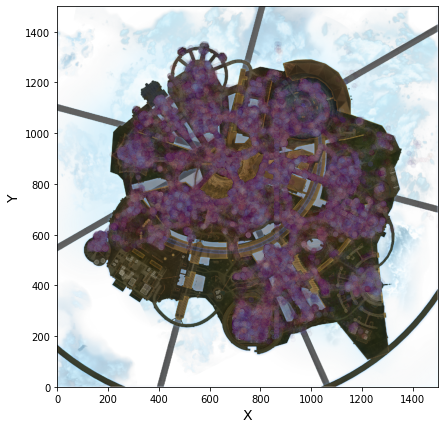

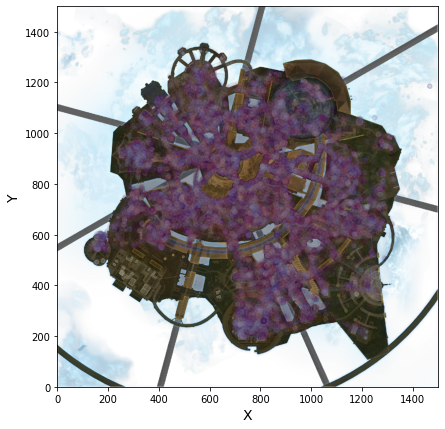

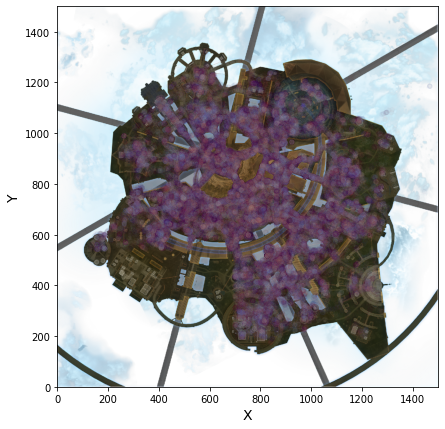

...

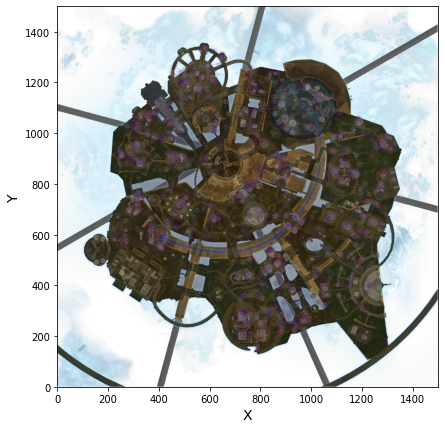

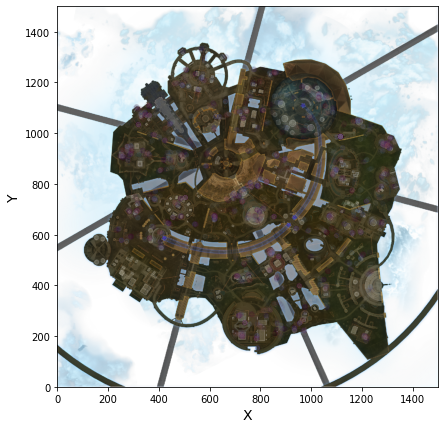

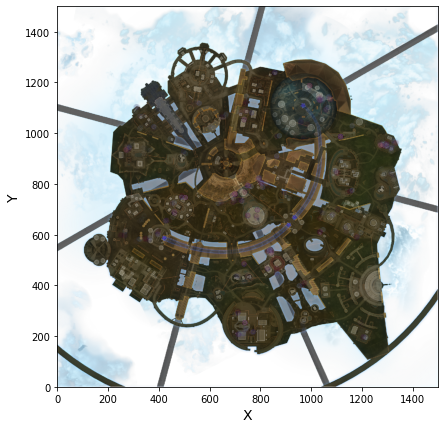

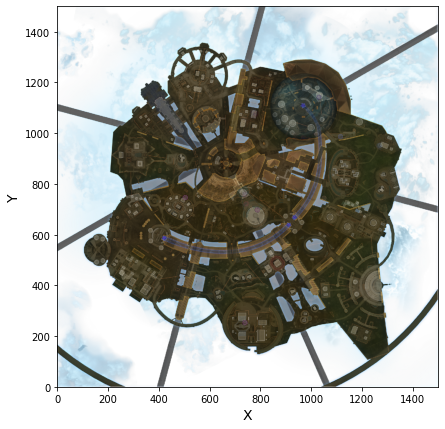

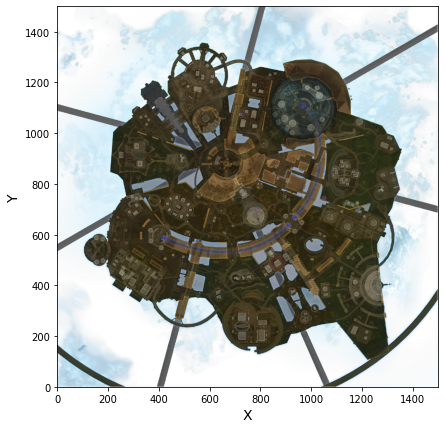

In [ ]:
#tx = [tx8]

images_path = os.path.join('./', "/content/drive/MyDrive/")
os.makedirs(images_path, exist_ok=True)
filename = "L01,R1,C1,background,visible,normal,255.png"
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
from skimage.exposure import equalize_hist
for loop in tx:
  map_img=mpimg.imread(os.path.join(images_path, filename))
  ax = loop.plot(kind='scatter', x="x", y="y", figsize=(10,7), c="time",
                      
                        cmap=plt.get_cmap("twilight"),
                       colorbar=False, alpha=0.02,
                      )
  

  plt.imshow(map_img, extent=[0, 1500, 0, 1500], alpha=1,
          cmap=plt.get_cmap("jet"))
  plt.ylabel("Y", fontsize=14)
  plt.xlabel("X", fontsize=14)

# setting up heatmap

  tick_values = np.linspace(alive.min(), alive.max(), 11)



plt.show()

In [ ]:
apex = pd.read_csv('/content/drive/MyDrive/new_data.csv')
f1 = pd.DataFrame([{'x': 285, 'y': 991, 'time':760},
                  {'x':200, 'y': 1200, 'time': 760}])
apex = pd.concat([f1,apex], ignore_index=True)

apex.head()

,x,y,time,Unnamed: 0,map,locations,time_landed,landed_location_index,landed_location,landed_name,locations_visited,rings,version
0,285.0,991.0,760.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,200.0,1200.0,760.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,4463.0,olympus.s8,"[[64.54, [838, 972]], [67.6, [839, 973]], [70....",67.60,1.0,"[840, 971]",Solar Array,"['Solar Array', 'Bonsai Hillside', 'Hammond La...",NaN,1.0
3,NaN,NaN,NaN,4464.0,olympus.s8,"[[58.57, [1058, 74]], [102.44, [838, 975]], [1...",108.41,3.0,"[839, 960]",Solar Array,"['Solar Array', 'Ivory Pass', 'Grow Towers', '...",NaN,1.0
4,NaN,NaN,NaN,4465.0,olympus.s8,"[[30.36, [702, 1027]], [50.59, [730, 747]], [5...",50.59,1.0,"[725, 811]",Hammond Labs,"['Hammond Labs', 'Turbine']",NaN,1.0


L01,R1,C1,background,visible,normal,255.png
L01,R1,C1,background,visible,normal,255.png
L01,R1,C1,background,visible,normal,255.png
L01,R1,C1,background,visible,normal,255.png
L01,R1,C1,background,visible,normal,255.png
L01,R1,C1,background,visible,normal,255.png
L01,R1,C1,background,visible,normal,255.png


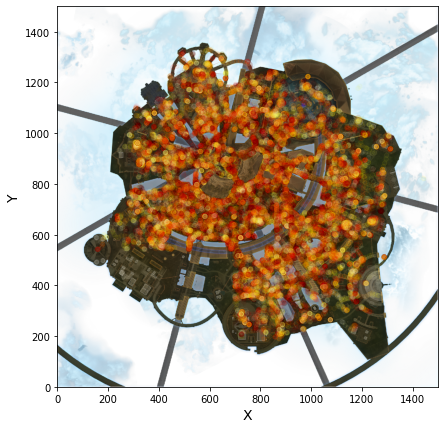

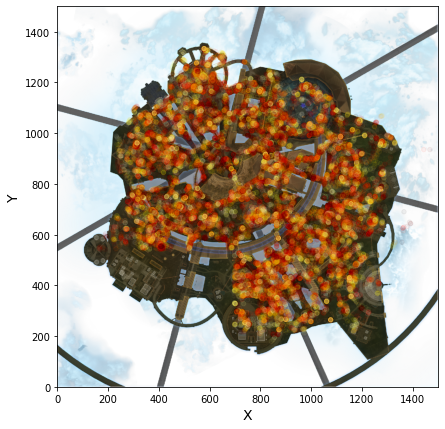

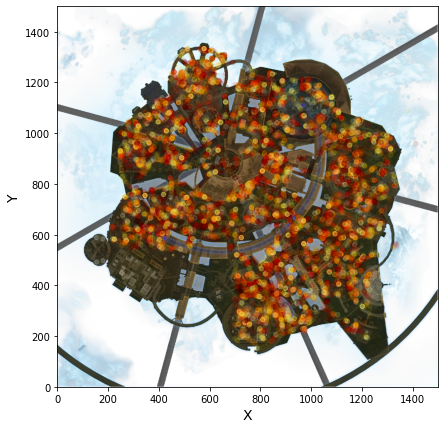

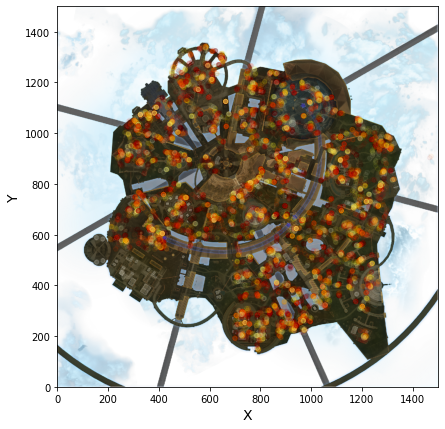

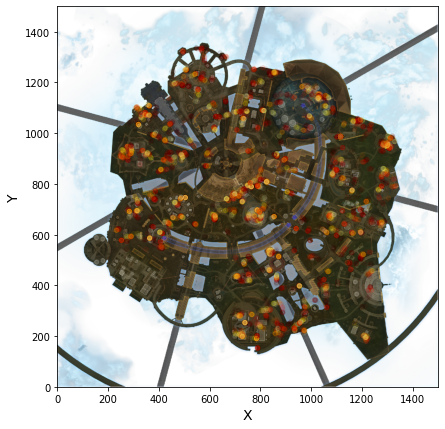

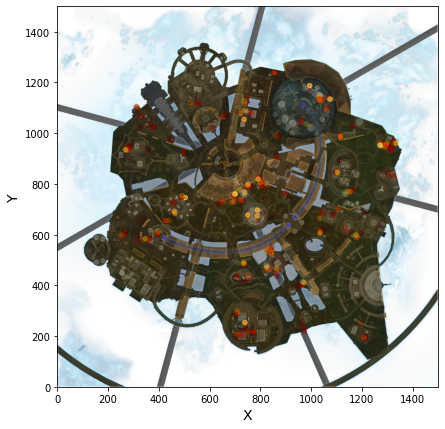

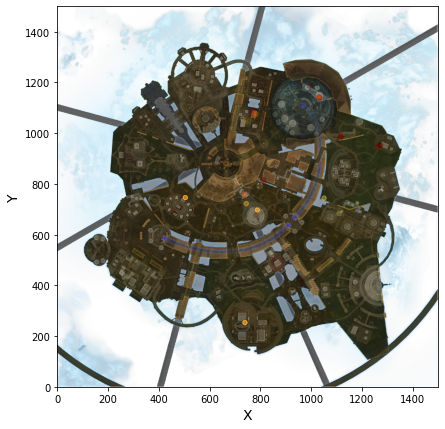

In [ ]:
tx = [tx9, tx10, tx11, tx12, tx13, tx14, tx15]

for loop in tx:

  images_path = os.path.join('./', "/content/drive/MyDrive/")
  os.makedirs(images_path, exist_ok=True)
  filename = "L01,R1,C1,background,visible,normal,255.png"
  print(filename)

  import matplotlib.image as mpimg
  import matplotlib.pyplot as plt
  map_img=mpimg.imread(os.path.join(images_path, filename))
  ax = loop.plot(kind='scatter', x="x", y="y", figsize=(10,7), c="time",
                      
                        cmap=plt.get_cmap("hot"),
                       colorbar=False, alpha=0.05,
                      )

  plt.imshow(map_img, extent=[0, 1500, 0, 1500], alpha=1,
          cmap=plt.get_cmap("jet"))
  plt.ylabel("Y", fontsize=14)
  plt.xlabel("X", fontsize=14)

# setting up heatmap

  tick_values = np.linspace(alive.min(), alive.max(), 11)



plt.show()

In [ ]:
#@title
tx2 = apex[(apex['time'] >= 101) & (apex['time'] <= 200)]

images_path = os.path.join('./', "/content/drive/MyDrive/Colab Notebooks/")
os.makedirs(images_path, exist_ok=True)
filename = "Olympus S08.jpg"
print(filename)

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
map_img=mpimg.imread(os.path.join(images_path, filename))
ax = tx2.plot(kind='scatter', x="x", y="y", figsize=(10,7), c="time",
                      
                        cmap=plt.get_cmap("hot"),
                       colorbar=False, alpha=1,
                      )

plt.imshow(map_img, extent=[0, 1500, 0, 1500], alpha=1,
          cmap=plt.get_cmap("jet"))
plt.ylabel("Y", fontsize=14)
plt.xlabel("X", fontsize=14)

# setting up heatmap

tick_values = np.linspace(alive.min(), alive.max(), 11)
cb = plt.colorbar()
cb.ax.set_yticklabels(["%ds"%(round(v*2)) for v in tick_values], fontsize=14)
cb.set_label('Time_Alive', fontsize=16)

Olympus S08.jpg


FileNotFoundError: ignored

In [ ]:
#@title
tx3 = apex[(apex['time'] >= 201) & (apex['time'] <= 300)]

images_path = os.path.join('./', "/content/drive/MyDrive/Colab Notebooks/")
os.makedirs(images_path, exist_ok=True)
filename = "Olympus S08.jpg"
print(filename)

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
map_img=mpimg.imread(os.path.join(images_path, filename))
ax = tx3.plot(kind='scatter', x="x", y="y", figsize=(10,7), c="time",
                      
                        cmap=plt.get_cmap("hot"),
                       colorbar=False, alpha=1,
                      )

plt.imshow(map_img, extent=[0, 1500, 0, 1500], alpha=1,
          cmap=plt.get_cmap("jet"))
plt.ylabel("Y", fontsize=14)
plt.xlabel("X", fontsize=14)

# setting up heatmap

tick_values = np.linspace(alive.min(), alive.max(), 11)
cb = plt.colorbar()
cb.ax.set_yticklabels(["%ds"%(round(v*2)) for v in tick_values], fontsize=14)
cb.set_label('Time_Alive', fontsize=16)

In [ ]:
#@title
tx4 = apex[(apex['time'] >= 301) & (apex['time'] <= 400)]

images_path = os.path.join('./', "/content/drive/MyDrive/Colab Notebooks/")
os.makedirs(images_path, exist_ok=True)
filename = "Olympus S08.jpg"
print(filename)

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
map_img=mpimg.imread(os.path.join(images_path, filename))
ax = tx4.plot(kind='scatter', x="x", y="y", figsize=(10,7), c="time",
                      
                        cmap=plt.get_cmap("hot"),
                       colorbar=False, alpha=1,
                      )

plt.imshow(map_img, extent=[0, 1500, 0, 1500], alpha=1,
          cmap=plt.get_cmap("jet"))
plt.ylabel("Y", fontsize=14)
plt.xlabel("X", fontsize=14)

# setting up heatmap

tick_values = np.linspace(alive.min(), alive.max(), 11)
cb = plt.colorbar()
cb.ax.set_yticklabels(["%ds"%(round(v*2)) for v in tick_values], fontsize=14)
cb.set_label('Time_Alive', fontsize=16)

In [ ]:
#@title
tx5 = apex[(apex['time'] >= 401) & (apex['time'] <= 500)]

images_path = os.path.join('./', "/content/drive/MyDrive/Colab Notebooks/")
os.makedirs(images_path, exist_ok=True)
filename = "Olympus S08.jpg"
print(filename)

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
map_img=mpimg.imread(os.path.join(images_path, filename))
ax = tx5.plot(kind='scatter', x="x", y="y", figsize=(10,7), c="time",
                      
                        cmap=plt.get_cmap("hot"),
                       colorbar=False, alpha=1,
                      )

plt.imshow(map_img, extent=[0, 1500, 0, 1500], alpha=1,
          cmap=plt.get_cmap("jet"))
plt.ylabel("Y", fontsize=14)
plt.xlabel("X", fontsize=14)

# setting up heatmap

tick_values = np.linspace(alive.min(), alive.max(), 11)
cb = plt.colorbar()
cb.ax.set_yticklabels(["%ds"%(round(v*2)) for v in tick_values], fontsize=14)
cb.set_label('Time_Alive', fontsize=16)

In [ ]:
#@title
tx6 = apex[(apex['time'] >= 501) & (apex['time'] <= 600)]

images_path = os.path.join('./', "/content/drive/MyDrive/Colab Notebooks/")
os.makedirs(images_path, exist_ok=True)
filename = "Olympus S08.jpg"
print(filename)

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
map_img=mpimg.imread(os.path.join(images_path, filename))
ax = tx6.plot(kind='scatter', x="x", y="y", figsize=(10,7), c="time",
                      
                        cmap=plt.get_cmap("hot"),
                       colorbar=False, alpha=1,
                      )

plt.imshow(map_img, extent=[0, 1500, 0, 1500], alpha=1,
          cmap=plt.get_cmap("jet"))
plt.ylabel("Y", fontsize=14)
plt.xlabel("X", fontsize=14)

# setting up heatmap

tick_values = np.linspace(alive.min(), alive.max(), 11)
cb = plt.colorbar()
cb.ax.set_yticklabels(["%ds"%(round(v*2)) for v in tick_values], fontsize=14)
cb.set_label('Time_Alive', fontsize=16)

In [ ]:
#@title
tx7 = apex[(apex['time'] >= 601) & (apex['time'] <= 700)]

images_path = os.path.join('./', "/content/drive/MyDrive/Colab Notebooks/")
os.makedirs(images_path, exist_ok=True)
filename = "Olympus S08.jpg"
print(filename)

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
map_img=mpimg.imread(os.path.join(images_path, filename))
ax = tx7.plot(kind='scatter', x="x", y="y", figsize=(10,7), c="time",
                      
                        cmap=plt.get_cmap("hot"),
                       colorbar=False, alpha=1,
                      )

plt.imshow(map_img, extent=[0, 1500, 0, 1500], alpha=1,
          cmap=plt.get_cmap("jet"))
plt.ylabel("Y", fontsize=14)
plt.xlabel("X", fontsize=14)

# setting up heatmap

tick_values = np.linspace(alive.min(), alive.max(), 11)
cb = plt.colorbar()
cb.ax.set_yticklabels(["%ds"%(round(v*2)) for v in tick_values], fontsize=14)
cb.set_label('Time_Alive', fontsize=16)

In [ ]:
#@title
tx8 = apex[(apex['time'] >= 701) & (apex['time'] <= 800)]

images_path = os.path.join('./', "/content/drive/MyDrive/Colab Notebooks/")
os.makedirs(images_path, exist_ok=True)
filename = "Olympus S08.jpg"
print(filename)

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
map_img=mpimg.imread(os.path.join(images_path, filename))
ax = tx8.plot(kind='scatter', x="x", y="y", figsize=(10,7), c="time",
                      
                        cmap=plt.get_cmap("hot"),
                       colorbar=False, alpha=1,
                      )

plt.imshow(map_img, extent=[0, 1500, 0, 1500], alpha=1,
          cmap=plt.get_cmap("jet"))
plt.ylabel("Y", fontsize=14)
plt.xlabel("X", fontsize=14)

# setting up heatmap

tick_values = np.linspace(alive.min(), alive.max(), 11)
cb = plt.colorbar()
cb.ax.set_yticklabels(["%ds"%(round(v*2)) for v in tick_values], fontsize=14)
cb.set_label('Time_Alive', fontsize=16)

In [ ]:
#@title
tx9 = apex[(apex['time'] >= 801) & (apex['time'] <= 900)]

images_path = os.path.join('./', "/content/drive/MyDrive/Colab Notebooks/")
os.makedirs(images_path, exist_ok=True)
filename = "Olympus S08.jpg"
print(filename)

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
map_img=mpimg.imread(os.path.join(images_path, filename))
ax = tx9.plot(kind='scatter', x="x", y="y", figsize=(10,7), c="time",
                      
                        cmap=plt.get_cmap("hot"),
                       colorbar=False, alpha=1,
                      )

plt.imshow(map_img, extent=[0, 1500, 0, 1500], alpha=1,
          cmap=plt.get_cmap("jet"))
plt.ylabel("Y", fontsize=14)
plt.xlabel("X", fontsize=14)

# setting up heatmap

tick_values = np.linspace(alive.min(), alive.max(), 11)
cb = plt.colorbar()
cb.ax.set_yticklabels(["%ds"%(round(v*2)) for v in tick_values], fontsize=14)
cb.set_label('Time_Alive', fontsize=16)

In [ ]:
#@title
tx10 = apex[(apex['time'] >= 901) & (apex['time'] <= 1000)]

images_path = os.path.join('./', "/content/drive/MyDrive/Colab Notebooks/")
os.makedirs(images_path, exist_ok=True)
filename = "Olympus S08.jpg"
print(filename)

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
map_img=mpimg.imread(os.path.join(images_path, filename))
ax = tx10.plot(kind='scatter', x="x", y="y", figsize=(10,7), c="time",
                      
                        cmap=plt.get_cmap("hot"),
                       colorbar=False, alpha=1,
                      )

plt.imshow(map_img, extent=[0, 1500, 0, 1500], alpha=1,
          cmap=plt.get_cmap("jet"))
plt.ylabel("Y", fontsize=14)
plt.xlabel("X", fontsize=14)

# setting up heatmap

tick_values = np.linspace(alive.min(), alive.max(), 11)
cb = plt.colorbar()
cb.ax.set_yticklabels(["%ds"%(round(v*2)) for v in tick_values], fontsize=14)
cb.set_label('Time_Alive', fontsize=16)

In [ ]:
#@title
tx11 = apex[(apex['time'] >= 1001) & (apex['time'] <= 1100)]

images_path = os.path.join('./', "/content/drive/MyDrive/Colab Notebooks/")
os.makedirs(images_path, exist_ok=True)
filename = "Olympus S08.jpg"
print(filename)

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
map_img=mpimg.imread(os.path.join(images_path, filename))
ax = tx11.plot(kind='scatter', x="x", y="y", figsize=(10,7), c="time",
                      
                        cmap=plt.get_cmap("hot"),
                       colorbar=False, alpha=1,
                      )

plt.imshow(map_img, extent=[0, 1500, 0, 1500], alpha=1,
          cmap=plt.get_cmap("jet"))
plt.ylabel("Y", fontsize=14)
plt.xlabel("X", fontsize=14)

# setting up heatmap

tick_values = np.linspace(alive.min(), alive.max(), 11)
cb = plt.colorbar()
cb.ax.set_yticklabels(["%ds"%(round(v*2)) for v in tick_values], fontsize=14)
cb.set_label('Time_Alive', fontsize=16)

In [ ]:
#@title
tx12 = apex[(apex['time'] >= 1101) & (apex['time'] <= 1200)]

images_path = os.path.join('./', "/content/drive/MyDrive/Colab Notebooks/")
os.makedirs(images_path, exist_ok=True)
filename = "Olympus S08.jpg"
print(filename)

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
map_img=mpimg.imread(os.path.join(images_path, filename))
ax = tx12.plot(kind='scatter', x="x", y="y", figsize=(10,7), c="time",
                      
                        cmap=plt.get_cmap("hot"),
                       colorbar=False, alpha=1,
                      )

plt.imshow(map_img, extent=[0, 1500, 0, 1500], alpha=1,
          cmap=plt.get_cmap("jet"))
plt.ylabel("Y", fontsize=14)
plt.xlabel("X", fontsize=14)

# setting up heatmap

tick_values = np.linspace(alive.min(), alive.max(), 11)
cb = plt.colorbar()
cb.ax.set_yticklabels(["%ds"%(round(v*2)) for v in tick_values], fontsize=14)
cb.set_label('Time_Alive', fontsize=16)

In [ ]:
#@title
tx13 = apex[(apex['time'] >= 1201) & (apex['time'] <= 1300)]

images_path = os.path.join('./', "/content/drive/MyDrive/Colab Notebooks/")
os.makedirs(images_path, exist_ok=True)
filename = "Olympus S08.jpg"
print(filename)

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
map_img=mpimg.imread(os.path.join(images_path, filename))
ax = tx13.plot(kind='scatter', x="x", y="y", figsize=(10,7), c="time",
                      
                        cmap=plt.get_cmap("hot"),
                       colorbar=False, alpha=1,
                      )

plt.imshow(map_img, extent=[0, 1500, 0, 1500], alpha=1,
          cmap=plt.get_cmap("jet"))
plt.ylabel("Y", fontsize=14)
plt.xlabel("X", fontsize=14)

# setting up heatmap

tick_values = np.linspace(alive.min(), alive.max(), 11)
cb = plt.colorbar()
cb.ax.set_yticklabels(["%ds"%(round(v*2)) for v in tick_values], fontsize=14)
cb.set_label('Time_Alive', fontsize=16)

In [ ]:
#@title
tx14 = apex[(apex['time'] >= 1301) & (apex['time'] <= 1400)]

images_path = os.path.join('./', "/content/drive/MyDrive/Colab Notebooks/")
os.makedirs(images_path, exist_ok=True)
filename = "Olympus S08.jpg"
print(filename)

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
map_img=mpimg.imread(os.path.join(images_path, filename))
ax = tx14.plot(kind='scatter', x="x", y="y", figsize=(10,7), c="time",
                      
                        cmap=plt.get_cmap("hot"),
                       colorbar=False, alpha=1,
                      )

plt.imshow(map_img, extent=[0, 1500, 0, 1500], alpha=1,
          cmap=plt.get_cmap("jet"))
plt.ylabel("Y", fontsize=14)
plt.xlabel("X", fontsize=14)

# setting up heatmap

tick_values = np.linspace(alive.min(), alive.max(), 11)
cb = plt.colorbar()
cb.ax.set_yticklabels(["%ds"%(round(v*2)) for v in tick_values], fontsize=14)
cb.set_label('Time_Alive', fontsize=16)

In [ ]:
#@title
tx15 = apex[(apex['time'] >= 1401) & (apex['time'] <= 1500)]

images_path = os.path.join('./', "/content/drive/MyDrive/Colab Notebooks/")
os.makedirs(images_path, exist_ok=True)
filename = "Olympus S08.jpg"
print(filename)

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
map_img=mpimg.imread(os.path.join(images_path, filename))
ax = tx15.plot(kind='scatter', x="x", y="y", figsize=(10,7), c="time",
                      
                        cmap=plt.get_cmap("hot"),
                       colorbar=False, alpha=1,
                      )

plt.imshow(map_img, extent=[0, 1500, 0, 1500], alpha=1,
          cmap=plt.get_cmap("jet"))
plt.ylabel("Y", fontsize=14)
plt.xlabel("X", fontsize=14)

# setting up heatmap

tick_values = np.linspace(alive.min(), alive.max(), 11)
cb = plt.colorbar()
cb.ax.set_yticklabels(["%ds"%(round(v*2)) for v in tick_values], fontsize=14)
cb.set_label('Time_Alive', fontsize=16)

In [ ]:
#@title
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

mages_path = os.path.join('./', "/content/drive/MyDrive/Colab Notebooks/")
os.makedirs(images_path, exist_ok=True)
filename = "Olympus S08.jpg"
print(filename)

map_img=mpimg.imread(os.path.join(images_path, filename))
plt.imshow(map_img, extent=[0, 1500, 0, 1500], alpha=1,
           cmap=plt.get_cmap("hot"))
plt.ylabel("Y", fontsize=14)
plt.xlabel("X", fontsize=14)

y = apex["y"]
x = apex["x"]

sns.jointplot(x=x, y=y, kind='hex', height=5)
plt.show()

In [ ]:
with open('/content/drive/MyDrive/Colab Notebooks/out2.csv', "r") as file:
  df = pd.read_csv(file)
  print(type(df))
  x1 = []
  y2 = []
  print(df['landed_location'])
  for a in df['landed_location']:
    b = int(a.find(','))
    x1.append(float(a[1:b]))
    y2.append(float(a[b+2:len(a)-1]))
    #x.append)
apex = pd.DataFrame({'x':x1, 'y':y2})